In [1]:
!pip install noisereduce

In [2]:
import librosa
import noisereduce as nr
import numpy as np
from IPython.display import Audio
import math

/opt/anaconda3/lib/python3.8/site-packages/noisereduce/noisereduce.py:5: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm


In [45]:
path = '/Users/airpenha/Projects/python/pmo/131139Z.mp3'
data, fs = librosa.load(path)

/opt/anaconda3/lib/python3.8/site-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


In [46]:
time = np.arange(0, len(data))/fs
n = len(time)
total_time_seconds = len(data)/fs

  0%|          | 0/7 [00:00<?, ?it/s]

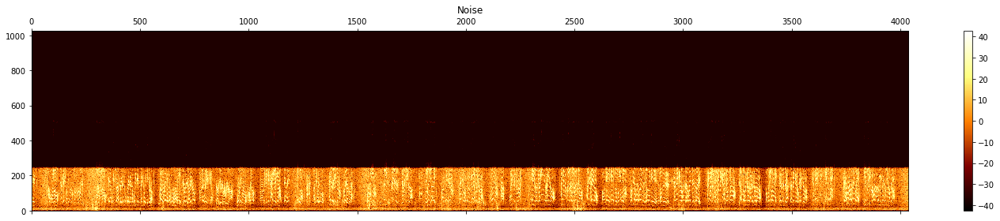

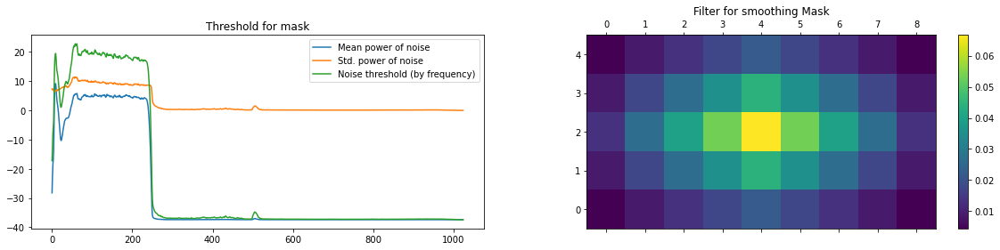

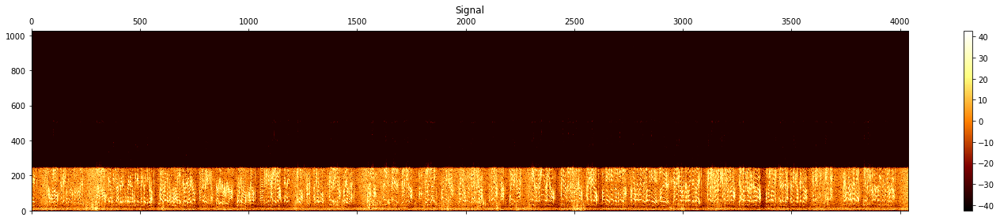

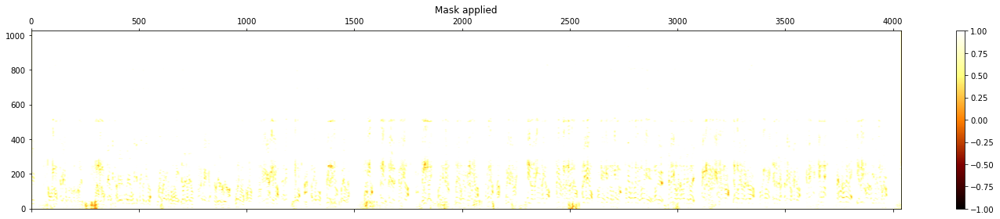

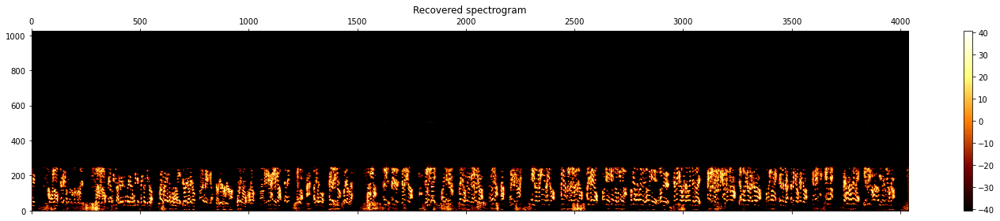

In [47]:
time_end = math.floor(time[n-1])
noisy_part = data[0:3627534]
# perform noise reduction
reduced_noise = nr.reduce_noise(audio_clip=data, noise_clip=noisy_part, verbose=True)

In [48]:
Audio(data=reduced_noise,rate=fs)

In [58]:
snr = 20 # signal to noise ratio = 20
noise_clip = data/snr
audio_clip_filtred = reduced_noise + noise_clip

In [55]:
Audio(data=audio_clip_cafe,rate=fs)

In [59]:
noise_reduced = nr.reduce_noise(audio_clip=reduced_noise.astype('float32'),
                                noise_clip=noise_clip.astype('float32'),
                                use_tensorflow=True, 
                                verbose=False)

In [60]:
Audio(data=noise_reduced,rate=fs)